# Sugar Scape Case Study: Sweet Suprises about Society
Writen and Coded by: Gerardo Cisneros Mendoza(Student No. 21993026) & Rhys Collier(Student No. 22222918)

## Chapter 0 - In the beginning...
Resource allocation, life, death, sex, conflict, culture, evolution, trade, and disease are all components of human societies. These components have helped to drive own lives, the lives of those around us, and every person that has ever lived throughout history of. But these components are also an important part of another type of society and environment that exists within its own universe and even has its own history. 

This universe and world is the sugarscape, an agent-based computational model that creates miniature societies to help us to understand our own societies.

The sugarscape, like our own society, has a long history, be it a shorter history, which started nearly 50 years ago. In 1969 Thomas C. Schelling, an economist from the University of Maryland, released the paper "Models of Segregation"[1]. This paper laid down the basis for agent-based modelling, but due to the limited computer power at the time the model was simplistic and small. As time passed and computer become more powerful, there was a greater quantity that could be achieved by computational models. This was especially true with "life like" simulation and the graphical representation of these. One of the most famous of these early pioneering models is the appropriately named "Game of Life".

In 1996 Joshua M. Epstein and Robert Axtell released their book "Growing Artificial Societies: Social Science from the bottom up"[2]. It was this book that outlined the basics for what the world has come to know as the sugarscape of today. This case study will highlight and expanding upon some of the experiments covered in that book and look at some other interesting areas.

All the topics and experiments covered in this Case Study will be written in python code and will be explained. However, it has been assumed that the reader of this document will have a basic understanding of python and its commands. With this in mind explanation will not be provided on the more basic level parts of the code. Before any complicated procedures and code can be started there is a requirement to lay out the basics components of what a sugarscape is and how it operates.

### Components of this New World
 In simplicity a sugarscape consists of 3 overall components, which are:
>___Environment:___ A 2-dimensional lattice, or grid, that can hold values in discreet regions. In its simplicity the lattice can hold a set of values that represent resources, but it can also represents a wide variant of information. It is a medium that allows "Agents" to act within.

>___Agents:___ The agents are the subjects of this simulation and can be considered the "people" of this "Enviroment". They are often governed by fixed and dynamic rules that effect what decisions are made over the progress of the simulation. 

>___Rules:___ Rules represent the decision trees that agents take to perform actions in the "Enviroment". There are 3 types of rules:
    
    >>Agent-Environment rules where due to the environment the agent does an action e.g. if grid x sugar > grid y sugar then agent a move to grid x. 
    
    >>Environment-Environment rules where the environment effects itself e.g. if grid y sugar is a then grid x sugar equal increases by 1/10th of grid y's sugar. 
    
    >>Agent-Agent rules are where agents interact with each other e.g. combat, mating, trading or such actions.

As the simulation runs the agents will proceed and act out the rules within the environment until the simulation is terminated, or all the agents "die". Without these 3 components the sugarscape could not function. However, as you might have noticed, those descriptions are rather broad and not specific. No set rules are laid out and this is the point. It provides the flexibility for a variety of different phenomena to be studied in a relatively similar environment, and to quote Epstein and Axtell, "function as a kind of laboratory, a compuTerrarium"[2].

With these definitions established it is now possible to start the coding and specific definitions for  Case Study.

### In The Beginning... There Was Sugar
The start of our python code will be to import several libraries and functions into our workspace. The functions within these libraries will allow us to save time by not having to rewrite existing functions, and to increase the efficiency of the code by using more well written and tested algorithms. It must be noted that libraries include everything that is need for the entire case study. Here are all the libraries and their determined use:
> ___numpy:___ numpy is at it's core a package for scientific computation and contains many functions in a variety of areas. However, this document's code will primarily use the library for it's "array objects", which are more efficient  computationally then their python equivalent, "lists". 

>___matplotlib:___ Is a 2D plotting library. It contains a variety of different plotting functions. For this document, the library will be used for its colours and "rc" parameters. 

>___warnings:___ A default python package to show and process warnings for display. Useful if anything goes wrong.

The remaining three imports are from files written by Allen B. Downey for his book "Think Complexity Version 2", and a copy of each of these files can be found on his github page https://github.com/AllenDowney/ThinkComplexity2.  

>___Cell2D:___ 

>___thinkplot:___

>___thinkstats2:___ 

The code set below will import all these mentioned libaries.

In [51]:
from __future__ import print_function, division

%matplotlib inline

import numpy as np

import matplotlib.pyplot as plt
from   matplotlib import rc
from   matplotlib.colors import LinearSegmentedColormap
rc('animation', html='html5')


import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning)

from Cell2D import Cell2D, Cell2DViewer
from scipy.signal import correlate2d

import thinkplot
from thinkstats2 import Cdf
from thinkstats2 import RandomSeed

plt.rcParams['animation.ffmpeg_path'] = 'C:\\ffmpeg\\bin\\ffmpeg.exe'

Now that the appropriate libraries and functions have been imported, the coding of the environment can be conducted and will allow for a more definite definition of what sugar and the environment really is.

Our environment will be represented on a 2-dimensional lattice or grid with discrete integer values for every point, or discrete whole numbers. These integer values represent the "sugar", a resource that agents must eat to survive or use to perform other actions. In some ways it represents the energy of our world, be it oil, food or the sun. Due to this, it is usually sought after by agents in their programming.

To store our environment the code will not be utilising a typical python list, dynamic array, but instead will use a numpy array. As it improves performance by reducing the operation counts performed during run time, and gives access to several functions not available to python lists. The reason for this is complicated and will not be discussed further here.

With the basic foundational storage unit put down for the environment there are a variety of different rules for the regrowth of sugar in the system that could be used. Here are a few examples:

    - Sugar grows up instantly to its capacity.
    - Sugar grows up at a rate of unit per time step.
    - Sugar grows up at different rates in different regions of the sugarscape.
    - Sugar grows up based on the sugar level of its neighbouring sites.

For the first few experiments a fixed growth rate of sugar per unit time will e used, up to some maximum value determined at the start of the simulation represented by a second static numpy array. This will allows for a much more controlled, but varied input rate of sugar into the environment. With this information established the foundations for the environment can be laid with the following code.

In [52]:
# The following temporary classes will use to help break up the code 
#   into easily viewable chunks as the explination is provided. The 
#   entire thing will be redefined again in sugarscape class later
#   on in the document.

# Our enviroment class that will retain all the enviroment variables
#   and rules.
class SugarscapeTemp(Cell2D):
    """Represents an Epstein-Axtell Sugarscape."""
    
    def __init__(self, n, **params):
        """Initializes the attributes.

        n: number of rows and columns
        params: dictionary of parameters
        """
        self.n = n
        self.params = params
        
        # track variables
        self.grow_rate = params.get('growth_rate', 4)
        self.sugarpeaks = params.get('sugarpeaks', [[15,15],[35,35]])
        self.capacity,self.higher_capacity_locations  = self.make_capacity()
        #self.higher_capacity_locations
        
        # initially all cells are at capacity
        self.array = self.capacity.copy()
         
    def make_capacity(self):
        """Makes the capacity array. This is done primarily by calculating the
           minimum distance between any of the peaks and the point in the
           array. This distance is then assigned a value depending on this
           minimum value."""
        
        # compute the distance of each cell from the peaks. 
        x = np.arange(self.n) # most numpy, np, operators create a numpy  array
        rows, cols = np.meshgrid(x, x, indexing='ij')
        
        # each cell in `rows` contains its own `i` coordinate
        # each cell in `cols` contains its `j` coordinate
        # creates the sugar peaks at this positions
        distHypots = []
        dist = np.hypot(rows-self.sugarpeaks[0][0], cols-self.sugarpeaks[0][1])
        for sugarpeakPos in self.sugarpeaks:
            distHypots.append(np.hypot(rows-sugarpeakPos[0], cols-sugarpeakPos[1]))
        
        for distHypot in distHypots:
            dist = np.minimum(dist, distHypot)
        
        # cells in the capacity array are set according to dist from peak
        a = np.zeros((self.n, self.n), np.float)
        a[dist>=16] = 1
        a[dist<16] = 2
        a[dist<11] = 3
        a[dist<6] = 4
        higher_capacity_counter = len(a[dist<6] == 4)
        
        return a, higher_capacity_counter 
    
    def grow(self):
        """Adds sugar to all cells and caps them by capacity."""
        grow_rate = self.params.get('grow_rate', self.grow_rate)
        self.array = np.minimum(self.array + grow_rate, self.capacity)
        
# This class will allow us to display our enviroment for easy viewing.
class SugarscapeViewerTemp(Cell2DViewer):
    """Generates visualization and animation of Sugarscape."""
    
    cmap = plt.get_cmap('YlOrRd')
    
    options = dict(interpolation='none', alpha=0.8,
                   vmin=0, vmax=9)
    
    def draw(self, grid=False):
        """Draws the array and any other elements.
        
        grid: boolean, whether to draw grid lines
        """
        self.draw_array(self.viewee.array, origin='lower')

A quick visualisation of the enviroment can be made by plotting it. It must be noted that the functions and classes used here will be explained in detail later on in the document. 

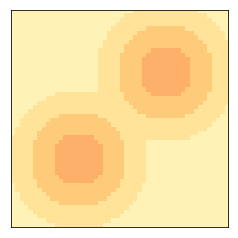

In [53]:
# if the following block of code providing the error
#   "name 'Sugarscape' is not defined" then simply
#   use "run all" function under "Cell" tab and 
#   try again. 
envA = SugarscapeTemp(50)
viewerA = SugarscapeViewerTemp(envA)
viewerA.draw()

___Figure 1:___ Default environment configuration

This is the default configuration for our environment. In the code above, it is possible to define the layout for the world. This is achieved by using the sugar peaks parameter that takes in a standard python list and outputs different world with the array values corresponding with sugar peaks. Figure 2 shows a number of different configurations that includes 1 to 5 peaks and a horizontal and vertical line enviroment:

In [54]:
sugarpeaksA    = [ [25,25] ]  # One main central sugar peak
sugarpeaksB    = [ [15,15], [35,35] ] # Standard sugar peaks as book replicates it
sugarpeaksC    = [ [10,13], [24,36], [37,12] ] # 3 sugar peaks
sugarpeaksD    = [ [10,10], [40,10], [10,40], [40,40] ] # 4 sugar peaks
sugarpeaksE = [ [10,10], [40,10], [25,25], [10,40], [40,40] ] # 5 sugar peaks

sugarpeaksHorz = []
sugarpeaksVert = []

for i in range(0, 50):
    sugarpeaksHorz.append([25,i])
    sugarpeaksVert.append([i,25])

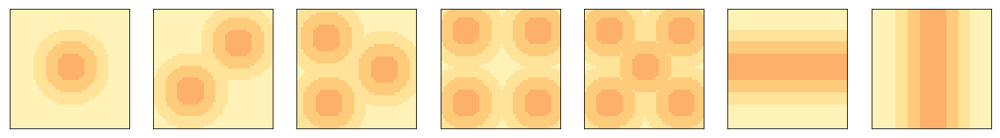

In [55]:
sugarpeaksA    = [ [25,25] ]  # One main central sugar peak
sugarpeaksB    = [ [15,15], [35,35] ] # Standard sugar peaks as book replicates it
sugarpeaksC    = [ [10,13], [24,36], [37,12] ] # 3 sugar peaks
sugarpeaksD    = [ [10,10], [40,10], [10,40], [40,40] ] # 4 sugar peaks
sugarpeaksE = [ [10,10], [40,10], [25,25], [10,40], [40,40] ] # 5 sugar peaks

sugarpeaksHorz = []
sugarpeaksVert = []

for i in range(0, 50):
    sugarpeaksHorz.append([25,i])
    sugarpeaksVert.append([i,25])

envA    = SugarscapeTemp(50, sugarpeaks=sugarpeaksA)
envB    = SugarscapeTemp(50, sugarpeaks=sugarpeaksB)
envC    = SugarscapeTemp(50, sugarpeaks=sugarpeaksC)
envD    = SugarscapeTemp(50, sugarpeaks=sugarpeaksD)
envE    = SugarscapeTemp(50, sugarpeaks=sugarpeaksE)
envHorz = SugarscapeTemp(50, sugarpeaks=sugarpeaksHorz)
envVert = SugarscapeTemp(50, sugarpeaks=sugarpeaksVert) 

fig = plt.figure(figsize = (20,20))

ax1 = fig.add_subplot(1,7,1)
viewerA  =  SugarscapeViewerTemp(envA)
viewerA.draw()

ax2 = fig.add_subplot(1,7,2)
viewerB  =  SugarscapeViewerTemp(envB)
viewerB.draw()

ax3 = fig.add_subplot(1,7,3)
viewerC  =  SugarscapeViewerTemp(envC)
viewerC.draw()

ax4 = fig.add_subplot(1,7,4)
viewerD  =  SugarscapeViewerTemp(envD)
viewerD.draw()

ax5 = fig.add_subplot(1,7,5)
viewerE  =  SugarscapeViewerTemp(envE)
viewerE.draw()

ax6 = fig.add_subplot(1,7,6)
viewerHorz  =  SugarscapeViewerTemp(envHorz)
viewerHorz.draw()

ax7 = fig.add_subplot(1,7,7)
viewerVert  =  SugarscapeViewerTemp(envVert)
viewerVert.draw()

___Figure 2:___ A variety of different enviroments from different intital starting conditions

With this foundation set for the environment and sugar, the coding of agents can be conducted.

### Then there was life
Agents are the creatures of the sugarscape world. This section of the document will look at defining these agents and the basic agent-environment rules for the experiments.

The first major rule is that all agents exist within the environment and occupy a cell within the environmental lattice. It is not possible for other agents to occupy a cell already occupied by another agent. However, it is possible for an agent to jump over any number of cells if it can do so. With that in mind, agents are also able to move throughout the environment, but they can only move north, south, east and west, not diagonally. They can move any number of squares they wish. These rules were decided upon for simplicity rather than any other reason. It is entirely possible to conduct a sugarscape that allows for agents to travel in any direction and be limited by a certain movement range.

Secondly, to give the agents some purpose in their movements with the environment, the agents will be able to "see" or "sense" the sugar around them. All agents will have a sight attribute that will be used to determine how far they can "see" in any of the 4 movable directions, north, south, east, and west. "Seeing" involves returning the value of the "sugar" present at those points in the environment. Figure 3 helps to visualise this. The blue regions represent the points viewable by the agent.

<img src="vision_location_grid.png">
___Figure 3:___ What an agent would be able to see with a viewable distance of 2 at position 0,0

This can easily replicated through the following code, which outputs an array of all viewable points and is organised from closest to furthest away.

In [56]:
def make_visible_locs(vision):
    """Computes the kernel of visible cells. The cells are
    at sorted in increasing distances from the centre. The
    cells at each distance are shuffled.
        
    vision: int distance
    """
    def make_array(d):
        """Generates visible cells with increasing distance."""
        a = np.array([[-d, 0], [d, 0], [0, -d], [0, d]])
        np.random.shuffle(a)
        return a
                     
    arrays = [make_array(d) for d in range(1, vision+1)]
    return np.vstack(arrays)

make_visible_locs(2)

array([[ 0,  1],
       [ 0, -1],
       [-1,  0],
       [ 1,  0],
       [ 0, -2],
       [ 0,  2],
       [-2,  0],
       [ 2,  0]])

In addition, the world itself will be treated like a torus, as demonstrated in figure 10. In other world the world raps around on itself like the old style 2d arcade games, like Asteroid and Pac-Man. Agents will be able to move from one side of the environment to the corresponding side on the other edge.

<img src="Torus_from_rectangle.gif">
___Figure 4:___ Flat plane being turned into a torus.[reference wikipedia]

With this in place an agent will be able to move to any point it wants within its sight range. To begin with it will be the point with the greatest quantity of sugar. Once it has arrived there, the agent will collect the sugar on the tile and add it to some internal value, representing stored sugar. Finally, the only agent-agent rule, currently, will be that each agent will have an internal value called metabolism, which will determine how much sugar will be consumed from the agents internal stored total at each time step.

Now that the rules have established the agents will be required to store the following current values:
    - Stored Sugar: Total amount of sugar collected and not consumed by the agent
    - Position: Where the agent is within the environment
    - Sight value: How far the agent can see
    - Metabolism: How much sugar is consumed each time step.
    
With that it is now possible to provide the code for the agents, under the _Agent_ class. 

In [57]:
# The following temporary classes will use to help break up the code 
#   into easily viewable chunks as the explination is provided. The 
#   entire thing will be redefined again in sugarscape class later
#   on in the document.

class AgentTemp:
    
    def __init__(self, loc, params):
        """Creates a new agent at the given location.
        
        loc: tuple coordinates
        params: dictionary of parameters
        """
        self.loc = tuple(loc)

        # extract the parameters
        max_vision = params.get('max_vision', 6)
        max_metabolism = params.get('max_metabolism', 4)
        min_sugar = params.get('min_sugar', 5)
        max_sugar = params.get('max_sugar', 25)
        
        # choose attributes
        self.vision = np.random.randint(1, max_vision+1)
        self.metabolism = np.random.uniform(1, max_metabolism)
        self.sugar = np.random.uniform(min_sugar, max_sugar)
        self.color = self.agent_color()

    def step(self, env):
        """Look around, move, and harvest.
        
        env: Sugarscape
        """
        self.loc = env.look_around(self.loc, self.vision)
        self.sugar += env.harvest(self.loc) - self.metabolism


    def agent_color(self):
        if self.metabolism <= 2: 
            return 'green'
        elif self.metabolism <= 3:
            return 'blue'
        elif self.metabolism <= 4:
            return 'red' 
        else: 
            return'yellow'

As is apparent, there are several calls to some environment functions not actually present in the original code. These functions will implement the agents ability to moving and collecting sugar. Some other functions have been added to store the agents within the environment class as well as functions to add agents to the world.

In [58]:
# The following temporary classes will use to help break up the code 
#   into easily viewable chunks as the explination is provided. The 
#   entire thing will be redefined again in sugarscape class later
#   on in the document.

# Function used for generating list of locations to place agents at 
#   the begining of the simulation.
# The following temporary classes will use to help break up the code 
#   into easily viewable chunks as the explination is provided. The 
#   entire thing will be redefined again in sugarscape class later
#   on in the document.

# Function used for generating list of locations to place agents at 
#   the begining of the simulation.
def make_locs(n, m):
    """Makes array where each row is an index in an `n` by `m` grid.
    
    n: int number of rows
    m: int number of cols
    
    returns: NumPy array
    """
    left = np.repeat(np.arange(m), n)
    right = np.tile(np.arange(n), m)
    return np.transpose([left, right])

class SugarscapeTemp(Cell2D):
    """Represents an Epstein-Axtell Sugarscape."""
    
    def __init__(self, n, **params):
        """Initializes the attributes.

        n: number of rows and columns
        params: dictionary of parameters
        """
        self.n = n
        self.params = params
        
        # track variables
        self.agent_count_seq = []
        self.grow_rate = params.get('growth_rate', 4)
        self.sugarpeaks = params.get('sugarpeaks', [[15,15],[35,35]])
        self.capacity,self.higher_capacity_locations  = self.make_capacity()
        #self.higher_capacity_locations
        
        # initially all cells are at capacity
        self.array = self.capacity.copy()
        
        # make the agents
        self.make_agents()
        self.agents = self.make_agents()
        
        
    def make_capacity(self):
        """Makes the capacity array."""
        
        # compute the distance of each cell from the peaks. 
        x = np.arange(self.n)
        rows, cols = np.meshgrid(x, x, indexing='ij')
        
        # each cell in `rows` contains its own `i` coordinate
        # each cell in `cols` contains its `j` coordinate
        # creates the sugar peaks at this positions
        distHypots = []
        dist = np.hypot(rows-self.sugarpeaks[0][0], cols-self.sugarpeaks[0][1])
        for sugarpeakPos in self.sugarpeaks:
            distHypots.append(np.hypot(rows-sugarpeakPos[0], cols-sugarpeakPos[1]))
        
        for distHypot in distHypots:
            dist = np.minimum(dist, distHypot)
        
        # cells in the capacity array are set according to dist from peak
        a = np.zeros((self.n, self.n), np.float)
        a[dist>=16] = 1
        a[dist<16] = 2
        a[dist<11] = 3
        a[dist<6] = 4
        higher_capacity_counter = len(a[dist<6] == 4)
        
        return a, higher_capacity_counter 
    
    def grow(self):
        """Adds sugar to all cells and caps them by capacity."""
        grow_rate = self.params.get('grow_rate', self.grow_rate)
        self.array = np.minimum(self.array + grow_rate, self.capacity)
        
        
    def make_agents(self):
        """Makes the agents."""
        
        # determine where the agents start and generate locations
        n, m = self.params.get('starting_box', self.array.shape)
        locs = make_locs(n, m)
        np.random.shuffle(locs)

        # make the agents
        num_agents = self.params.get('num_agents', 400)
        self.agents = [AgentTemp(locs[i], self.params) 
                       for i in range(num_agents)]
        
        # keep track of which cells are occupied
        self.occupied = set(agent.loc for agent in self.agents)
        return self.agents
    
    def look_around(self, center, vision):
        """Finds the visible cell with the most sugar.
        
        center: tuple, coordinates of the center cell
        vision: int, maximum visible distance
        
        returns: tuple, coordinates of best cell
        """
        # find all visible cells
        locs = make_visible_locs(vision)
        locs = (locs + center) % self.n
        
        # convert rows of the array to tuples
        locs = [tuple(loc) for loc in locs]
        
        # select unoccupied cells
        empty_locs = [loc for loc in locs if loc not in self.occupied]
        
        # if all visible cells are occupied, stay put
        if len(empty_locs) == 0:
            return center
        
        # look up the sugar level in each cell
        t = [self.array[loc] for loc in empty_locs]
        
        # find the best one and return it
        # (in case of tie, argmax returns the first, which
        # is the closest)
        i = np.argmax(t)
        
        return empty_locs[i]
    
    def harvest(self, loc):
        """Removes and returns the sugar from `loc`.
        
        loc: tuple coordinates
        """
        sugar = self.array[loc]
        self.array[loc] = 0
        return sugar
    
    def step(self):
        """Executes one time step."""
        replace = self.params.get('replace', False)
        
        # loop through the agents in random order
        random_order = np.random.permutation(self.agents)
        for agent in random_order:
            
            # mark the current cell unoccupied
            self.occupied.remove(agent.loc)
            
            # execute one step
            agent.step(self)

            # mark its cell occupied
            self.occupied.add(agent.loc)

        # update the time series
        self.agent_count_seq.append(len(self.agents))
        
        # grow back some sugar
        self.grow()
        return len(self.agents)
    
    def add_agent(self):
        """Generates a new random agent.
                
        returns: new AgentTemp
        """
        new_agent = AgentTemp(self.random_loc(), self.params)
        self.agents.append(new_agent)
        self.occupied.add(new_agent.loc)
        return new_agent
    
    def random_loc(self):
        """Choose a random unoccupied cell.
        
        returns: tuple coordinates
        """
        while True:
            loc = tuple(np.random.randint(self.n, size=2))
            if loc not in self.occupied:
                return loc
            
    def agents_metabolism_counter(self):
        low_met = 0
        mid_met = 0
        high_met = 0
        for agent in self.agents:
            if agent.color=='green':
                low_met = low_met+1
            elif agent.color=='blue':
                mid_met=mid_met+1
            elif agent.color=='red':
                high_met=high_met+1
        return low_met, mid_met, high_met

In [59]:
class SugarscapeViewerTemp(Cell2DViewer):
    """Generates visualization and animation of Sugarscape."""
    
    cmap = plt.get_cmap('YlOrRd')
    
    options = dict(interpolation='none', alpha=0.8,
                   vmin=0, vmax=9)
    
    def draw(self, grid=False):
        """Draws the array and any other elements.
        
        grid: boolean, whether to draw grid lines
        """
        self.draw_array(self.viewee.array, origin='lower')
        self.draw_agents()

    def draw_agents(self):
        """Plots the agents.
        """
        self.p = []
        xs, ys, do_plotting = self.get_coords('green')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='green')[0]
            self.p.append(self.points)
            
        xs, ys, do_plotting = self.get_coords('blue')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='blue')[0]
            self.p.append(self.points)

            
        xsg, ysg, do_plotting = self.get_coords('red')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xsg, ysg, '.', color='red')[0]
            self.p.append(self.points)
            
        xs, ys, do_plotting = self.get_coords('yellow')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='yellow')[0]
            self.p.append(self.points)
        
    def animate_func(self, i):
        """Draws one frame of the animation."""
        Cell2DViewer.animate_func(self, i)
        
        xs, ys, do_anim = self.get_coords('green')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[0].set_data(np.array([xs, ys]))
            
        xs, ys, do_anim = self.get_coords('blue')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[1].set_data(np.array([xs, ys]))
            
        xs, ys, do_anim = self.get_coords('red')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[2].set_data(np.array([xs, ys]))
        """
        xs, ys = self.get_coords('all')
        self.points.set_data(np.array([xs, ys]))"""
        return self.im, self.p #points
           
    def get_coords(self, color):
        """Gets the coordinates of the agents.
        
        Transforms from (row, col) to (x, y).
        
        returns: tuple of sequences, (xs, ys)
        """
        xs = [[]]
        ys = [[]]
        agents = self.viewee.agents
        if color=='all':
            rows, cols = np.transpose([agent.loc for agent in agents])
            xs = cols + 0.5
            ys = rows + 0.5
            return xs,ys
        
        do_transpose = False
        for agent in agents:
            if agent.color==color:
                do_transpose = True
                break

        if do_transpose:
            rows, cols = np.transpose([agent.loc for agent in agents if agent.color==color])
            xs = cols + 0.5
            ys = rows + 0.5
            
        return xs, ys, do_transpose

With that in place it is now possible to run the first simple sugarscape and view our agents collecting sugar 

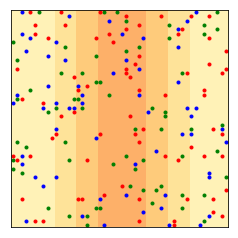

In [60]:
env = SugarscapeTemp(50,num_agents=200, sugarpeaks=sugarpeaksVert)
viewer = SugarscapeViewerTemp(env)

anim  =  viewer.animate(frames=300)

In [61]:
anim

That is the first simple sugarscape within this Case study. Even from the start the animal nature of the agents can be seen as they start to slowly move from their initial positions to the high sugar concentrated band in the middle of the environment. This also demonstrate that the code is working as intended. The agents moving towards the highest sugar point they can see, which results in them clumping together in the highest sugar zone as the simulation progresses.

From this point each chapter will focus on expanding the basic set of rules that have been defined to allow an analysis explaination of certain properties seen within our own enviroment and societies. 

The first of which will be establishment of death for our little world to examine carry capacity.

# Chapter 1 - Life and Death on the Sugarscape

Carrying capacity is defined in the oxford dictionary to be "The number of people, animals, or crops which a region can support without environmental degradation". In other words, it is can be considered the limit or maximum number of individuals that are sustainable over a prolonged period within a given region. In this section of the case study we will be using sugarscape to study carry capacity by varying the amount of high sugar zones within the environment. It would be expected that such an increase would result in an increase in the number of induvial that the area can sustain. To test this a sugarscape can be created at a considerably higher population, much greater than the potential carrying capacity, and observations could be made as the agents run out of food. However, there is one problem with this and that is the lack of appropriate rules within our current set to model the effects of "death" and "starvation" or their effective equivalent within the sugarscape world.

## The Rule of Death
To model the effects of starvation and death requires the addition of only one agent-agent rule to our current set within the simulation. The rule is:

>If an agent has 0 or less sugar within its reserves at any given time step it is removed from the simulation.

This simple rule should be enough to model the effect of overpopulation and carry capacity. In addition, it doesn't provide any additional complexities that might manipulate the effects of the simple analysis. 

To add this all into the code we will be adding function called _is starving_ to our _Agent_ class, that will be activated during each time step. It simply returns whether an agent has 0 sugar or less in its reserve. This is then used in a modified step class to decide whether the agent should be considered "dead" and removed from the simulation. The code below will implement these changes into our two classes.     

In [62]:
class Agent:
    
    def __init__(self, loc, params):
        """Creates a new agent at the given location.
        
        loc: tuple coordinates
        params: dictionary of parameters
        """
        self.loc = tuple(loc)
        self.age = 0
        #self.color = 'red'
        # extract the parameters
        max_vision = params.get('max_vision', 6)
        max_metabolism = params.get('max_metabolism', 4)
        min_lifespan = params.get('min_lifespan', 10000)
        max_lifespan = params.get('max_lifespan', 10000)
        min_sugar = params.get('min_sugar', 5)
        max_sugar = params.get('max_sugar', 25)
        
        # choose attributes
        self.vision = np.random.randint(1, max_vision+1)
        self.metabolism = np.random.uniform(1, max_metabolism)
        self.lifespan = np.random.uniform(min_lifespan, max_lifespan)
        self.sugar = np.random.uniform(min_sugar, max_sugar)
        self.color = self.agent_color()

    def step(self, env):
        """Look around, move, and harvest.
        
        env: Sugarscape
        """
        self.loc = env.look_around(self.loc, self.vision)
        self.sugar += env.harvest(self.loc) - self.metabolism
        self.age += 1

    def is_starving(self):
        """Checks if sugar has gone negative."""
        return self.sugar < 0

    def agent_color(self):
        if self.metabolism <= 2: 
            return 'green'
        elif self.metabolism <= 3:
            return 'blue'
        elif self.metabolism <= 4:
            return 'red' 
        else: 
            return'yellow'

In [188]:
class Sugarscape(Cell2D):
    """Represents an Epstein-Axtell Sugarscape."""
    
    def __init__(self, n, **params):
        """Initializes the attributes.

        n: number of rows and columns
        params: dictionary of parameters
        """
        self.n = n
        self.params = params
        
        # track variables
        self.agent_count_seq = []
        self.grow_rate = params.get('growth_rate', 4)
        self.sugarpeaks = params.get('sugarpeaks', [[15,15],[35,35]])
        self.capacity,self.higher_capacity_locations  = self.make_capacity()
        #self.higher_capacity_locations
        
        # initially all cells are at capacity
        self.array = self.capacity.copy()
        
        # make the agents
        self.make_agents()
        #self.agents = self.make_agents()
        
        
    def make_capacity(self):
        """Makes the capacity array."""
        
        # compute the distance of each cell from the peaks. 
        x = np.arange(self.n)
        rows, cols = np.meshgrid(x, x, indexing='ij')
        
        # each cell in `rows` contains its own `i` coordinate
        # each cell in `cols` contains its `j` coordinate
        # creates the sugar peaks at this positions
        distHypots = []
        dist = np.hypot(rows-self.sugarpeaks[0][0], cols-self.sugarpeaks[0][1])
        for sugarpeakPos in self.sugarpeaks:
            distHypots.append(np.hypot(rows-sugarpeakPos[0], cols-sugarpeakPos[1]))
        
        for distHypot in distHypots:
            dist = np.minimum(dist, distHypot)
        
        # cells in the capacity array are set according to dist from peak
        a = np.zeros((self.n, self.n), np.float)
        a[dist>=16] = 1
        a[dist<16] = 2
        a[dist<11] = 3
        a[dist<6] = 4
        higher_capacity_counter = len(a[dist<6] == 4)
        
        return a, higher_capacity_counter 
        
    def make_agents(self):
        """Makes the agents."""
        
        # determine where the agents start and generate locations
        n, m = self.params.get('starting_box', self.array.shape)
        locs = make_locs(n, m)
        np.random.shuffle(locs)

        # make the agents
        num_agents = self.params.get('num_agents', 400)
        self.agents = [Agent(locs[i], self.params) 
                       for i in range(num_agents)]
        
        # keep track of which cells are occupied
        self.occupied = set(agent.loc for agent in self.agents)
        return self.agents
            
    def grow(self):
        """Adds sugar to all cells and caps them by capacity."""
        grow_rate = self.params.get('grow_rate', self.grow_rate)
        self.array = np.minimum(self.array + grow_rate, self.capacity)
        
    def look_around(self, center, vision):
        """Finds the visible cell with the most sugar.
        
        center: tuple, coordinates of the center cell
        vision: int, maximum visible distance
        
        returns: tuple, coordinates of best cell
        """
        # find all visible cells
        locs = make_visible_locs(vision)
        locs = (locs + center) % self.n
        
        # convert rows of the array to tuples
        locs = [tuple(loc) for loc in locs]
        
        # select unoccupied cells
        empty_locs = [loc for loc in locs if loc not in self.occupied]
        
        # if all visible cells are occupied, stay put
        if len(empty_locs) == 0:
            return center
        
        # look up the sugar level in each cell
        t = [self.array[loc] for loc in empty_locs]
        
        # find the best one and return it
        # (in case of tie, argmax returns the first, which
        # is the closest)
        i = np.argmax(t)
        
        return empty_locs[i]
    
    def harvest(self, loc):
        """Removes and returns the sugar from `loc`.
        
        loc: tuple coordinates
        """
        sugar = self.array[loc]
        self.array[loc] = 0
        return sugar
    
    def step(self):
        """Executes one time step."""
        replace = self.params.get('replace', False)
        
        # loop through the agents in random order
        random_order = np.random.permutation(self.agents)
        for agent in random_order:
            
            # mark the current cell unoccupied
            self.occupied.remove(agent.loc)
            
            # execute one step
            agent.step(self)

            # if the agent is dead, remove from the list
            if agent.is_starving():
                self.agents.remove(agent)
                if replace:
                    self.add_agent()
            else:
                # otherwise mark its cell occupied
                self.occupied.add(agent.loc)

        # update the time series
        self.agent_count_seq.append(len(self.agents))
        
        # grow back some sugar
        self.grow()
        return len(self.agents)
    
    def add_agent(self):
        """Generates a new random agent.
                
        returns: new Agent
        """
        new_agent = Agent(self.random_loc(), self.params)
        self.agents.append(new_agent)
        self.occupied.add(new_agent.loc)
        return new_agent
    
    def random_loc(self):
        """Choose a random unoccupied cell.
        
        returns: tuple coordinates
        """
        while True:
            loc = tuple(np.random.randint(self.n, size=2))
            if loc not in self.occupied:
                return loc
            
    def agents_metabolism_counter(self):
        low_met = 0
        mid_met = 0
        high_met = 0
        for agent in self.agents:
            if agent.color=='green':
                low_met = low_met+1
            elif agent.color=='blue':
                mid_met=mid_met+1
            elif agent.color=='red':
                high_met=high_met+1
        return low_met, mid_met, high_met

In [189]:
class SugarscapeViewer(Cell2DViewer):
    """Generates visualization and animation of Sugarscape."""
    
    cmap = plt.get_cmap('YlOrRd')
    
    options = dict(interpolation='none', alpha=0.8,
                   vmin=0, vmax=9)
    
    def draw(self, grid=False):
        """Draws the array and any other elements.
        
        grid: boolean, whether to draw grid lines
        """
        self.draw_array(self.viewee.array, origin='lower')
        self.draw_agents()

    def draw_agents(self):
        """Plots the agents.
        """
        self.p = []
        xs, ys, do_plotting = self.get_coords('green')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='green')[0]
            self.p.append(self.points)
            
        xs, ys, do_plotting = self.get_coords('blue')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='blue')[0]
            self.p.append(self.points)

            
        xsg, ysg, do_plotting = self.get_coords('red')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xsg, ysg, '.', color='red')[0]
            self.p.append(self.points)
            
        xs, ys, do_plotting = self.get_coords('yellow')
        #if(xs.any()!=-1 and ys.any()!=-1):
        if(do_plotting):
            self.points = plt.plot(xs, ys, '.', color='yellow')[0]
            self.p.append(self.points)
        
    def animate_func(self, i):
        """Draws one frame of the animation."""
        Cell2DViewer.animate_func(self, i)
        
        xs, ys, do_anim = self.get_coords('green')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[0].set_data(np.array([xs, ys]))
            
        xs, ys, do_anim = self.get_coords('blue')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[1].set_data(np.array([xs, ys]))
            
        xs, ys, do_anim = self.get_coords('red')
        if do_anim:
            self.points.set_data(np.array([xs, ys]))
            self.p[2].set_data(np.array([xs, ys]))
        """
        xs, ys = self.get_coords('all')
        self.points.set_data(np.array([xs, ys]))"""
        return self.im, self.p #oints
           
    def get_coords(self, color):
        """Gets the coordinates of the agents.
        
        Transforms from (row, col) to (x, y).
        
        returns: tuple of sequences, (xs, ys)
        """
        xs = [[]]
        ys = [[]]
        agents = self.viewee.agents
        if color=='all':
            rows, cols = np.transpose([agent.loc for agent in agents])
            xs = cols + 0.5
            ys = rows + 0.5
            return xs,ys
        
        do_transpose = False
        for agent in agents:
            if agent.color==color:
                do_transpose = True
                break

        if do_transpose:
            rows, cols = np.transpose([agent.loc for agent in agents if agent.color==color])
            xs = cols + 0.5
            ys = rows + 0.5
            
        return xs, ys, do_transpose

#### The parameters of a world
To conduct our study on carry capacity certain variable/conditions will be kept at a constant throughout entirety of the simulations and study. These variables are as follows:
    - 50 unit world size.
    - World will be populated with 600 agents on initial creation.
    - Random position assignment for all agents on initial creation.
    - Random vision assignment for the agents (between 1 and 6 vision level)
    - Random metabolism assignment for the agents (between 1 and 4 metabolism level)
    - All agents will start with a random amount of sugar between 5 and 25.
    - Full capacity growth of the sugar after being harvested.

However, to provide varied results some parameters will need to be changed. In these experiments that will be the values within the capacity array of the sugar within the simulation. By varying the number of peaks, we effectively increase the amount of sugar available. So, in theory we should see a maximum carry capacity equal to the sum of the sugar capacity array divided by the average metabolism level for all agents. 

For our simulations we will use the one to five peak environments that we created back in chapter 0 of this case study, figures 2. For ease of convince these will be displayed again in their initial configurations in figure 5. To aid with these displays the total maximum sugar, sum of sugar capacity array, will be graphed and displayed as well in figure 6.

In [76]:
sugarpeaksA = [ [25,25] ]  # One main central sugar peak
sugarpeaksB = [ [15,15], [35,35] ] # Standard sugar peaks as book replicates it
sugarpeaksC = [ [10,13], [24,36], [37,12] ] # 3 sugar peaks
sugarpeaksD = [ [10,10], [40,10], [10,40], [40,40] ] # 4 sugar peaks
sugarpeaksE = [ [10,10], [40,10], [25,25], [10,40], [40,40] ] # 5 sugar peaks

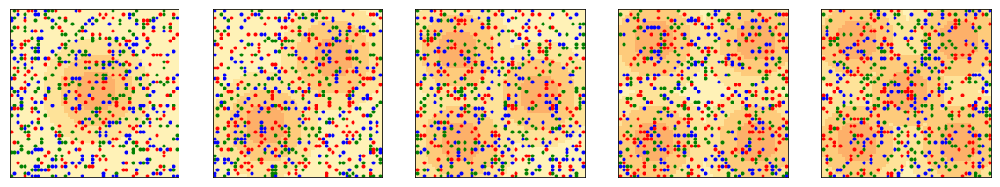

In [190]:
envA = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksA)
envB = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksB)
envC = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksC)
envD = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksD)
envE = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksE)

fig = plt.figure(figsize = (20,20))

ax1 = fig.add_subplot(1,5,1)
viewerA  =  SugarscapeViewer(envA)
viewerA.draw()

ax2 = fig.add_subplot(1,5,2)
viewerB  =  SugarscapeViewer(envB)
viewerB.draw()

ax3 = fig.add_subplot(1,5,3)
viewerC  =  SugarscapeViewer(envC)
viewerC.draw()

ax4 = fig.add_subplot(1,5,4)
viewerD  =  SugarscapeViewer(envD)
viewerD.draw()

ax5 = fig.add_subplot(1,5,5)
viewerE  =  SugarscapeViewer(envE)
viewerE.draw()



___Figure 5:___ Random inital conditions from 1 to 5 peaks


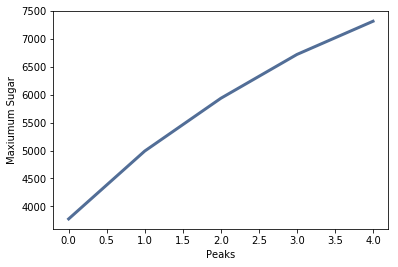

In [67]:
max_sugar = [np.sum(envA.capacity),
             np.sum(envB.capacity),
             np.sum(envC.capacity),
             np.sum(envD.capacity),
             np.sum(envE.capacity)];

thinkplot.plot(max_sugar)
thinkplot.Config(xlabel='Peaks',
                 ylabel='Maxiumum Sugar',
                 legend=False)

___Figure 6:___ Maximum possible sugar to be supplied each step for given number of peaks.

The above figure clearly shows an increasing total number of sugar per peak and Although it is not linear this is okay for the experiments that will be conducted as it will be still possible to observe the effective change in carry capacity. 

With these in place it is possible for the conduction of our experiments. However, we will perform an initial check of the random variable that were assigned and provide a way to checking the code. This will be done by viewing the accumulative distribution of agent vision, metabolism, and initial sugar quantities to ensure that they were coded correctly and that the random number generator is not bias.

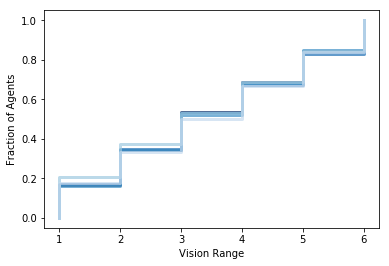

In [82]:
cdfA = Cdf(agent.vision for agent in envA.agents)
cdfB = Cdf(agent.vision for agent in envB.agents)
cdfC = Cdf(agent.vision for agent in envC.agents)
cdfD = Cdf(agent.vision for agent in envD.agents)
cdfE = Cdf(agent.vision for agent in envE.agents)
thinkplot.Cdf(cdfA)
thinkplot.Cdf(cdfB)
thinkplot.Cdf(cdfC)
thinkplot.Cdf(cdfD)
thinkplot.Cdf(cdfE)
thinkplot.Config(ylabel='Fraction of Agents',
                 xlabel='Vision Range',
                 legend=True)

___Figure 7:___ Accumulative distribution of agents by vision distance.


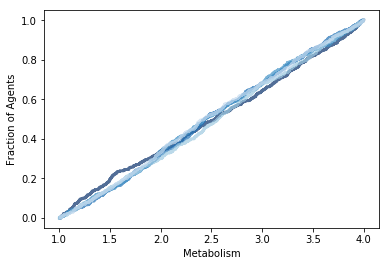

In [83]:
cdfA = Cdf(agent.metabolism for agent in envA.agents)
cdfB = Cdf(agent.metabolism for agent in envB.agents)
cdfC = Cdf(agent.metabolism for agent in envC.agents)
cdfD = Cdf(agent.metabolism for agent in envD.agents)
cdfE = Cdf(agent.metabolism for agent in envE.agents)
thinkplot.Cdf(cdfA)
thinkplot.Cdf(cdfB)
thinkplot.Cdf(cdfC)
thinkplot.Cdf(cdfD)
thinkplot.Cdf(cdfE)
thinkplot.Config(ylabel='Fraction of Agents',
                 xlabel='Metabolism',
                 legend=True)

___Figure 8:___ Accumulative distribution of agent metabolism.


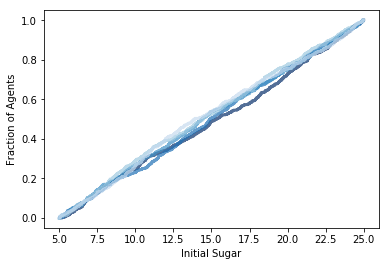

In [84]:
cdfA = Cdf(agent.sugar for agent in envA.agents)
cdfB = Cdf(agent.sugar for agent in envB.agents)
cdfC = Cdf(agent.sugar for agent in envC.agents)
cdfD = Cdf(agent.sugar for agent in envD.agents)
cdfE = Cdf(agent.sugar for agent in envE.agents)
thinkplot.Cdf(cdfA)
thinkplot.Cdf(cdfB)
thinkplot.Cdf(cdfC)
thinkplot.Cdf(cdfD)
thinkplot.Cdf(cdfE)
thinkplot.Config(ylabel='Fraction of Agents',
                 xlabel='Initial Sugar',
                 legend=True)

___Figure 9:___ Accumulative distribution of agent initial sugar total.

Figures 7-9 demonstrate a typical distrubution of random values that was to be expected. All sets of values are reasonably straight with some diviates from the average value but not to any alarming degree. In addition, the distrubutions show linear or  step increases indicating an even distrubiton of agents within each distinct whole region per catagory. However, due to the limited number of random values there should still be the chance that our random number generator is not performing as expected. So solve this the initial conditons will be generated 10,000 times and the average of all the agents generated taken and calculated. We should expect to see averages being equal to the following values for each catagory. 
    - Vision:        3.5
    - Metabolism:    2.5
    - Initial Sugar: 15.0

In [115]:
avg_vision     = 0
avg_metabolism = 0
avg_sugar      = 0

for i in range(0,10000):
    env = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksA)
    for agent in env.agents:
        avg_vision     += agent.vision
        avg_metabolism += agent.metabolism
        avg_sugar      += agent.sugar

avg_vision     /= 6000000
avg_metabolism /= 6000000
avg_sugar      /= 6000000

print('average vision = {0}\n average metabolism = {1}\n average initial sugar = {2}'.format(
      avg_vision, avg_metabolism, avg_sugar))

average vision = 3.500891
 average metabolism = 2.499931114283762
 average initial sugar = 15.002117125311507


Given that all values calculated were within 0.003 of the calculated averages, it is possible provide some certainty that the code and random number generator is operating correctly. Especially with this graphical and visual checking.

### Running a world
With the initial conditions in place we will run all of the different enviroments for 300 steps and observe the results. To help visulasation all the steps will be converted into animations for easy viewing The image below each animation is the final result of the simulation after 300 steps. After this the simulations will be reconducted 100 times to gather the average population per unit time, there is a variance in the maximum carry capacity depending on the initial condiction of the experiment.

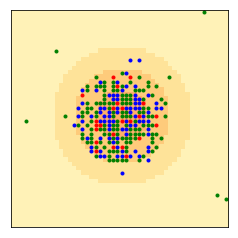

In [191]:
animA  =  viewerA.animate(frames=300)
animA

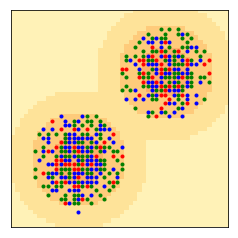

In [192]:
animB  =  viewerB.animate(frames=300)
animB

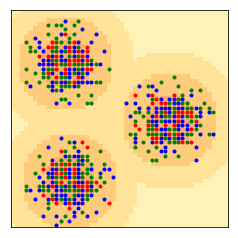

In [193]:
animC  =  viewerC.animate(frames=300)
animC

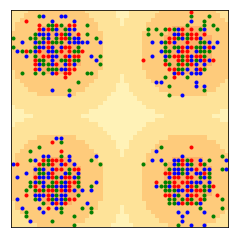

In [194]:
animD  =  viewerD.animate(frames=300)
animD

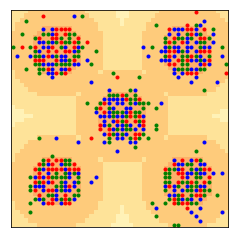

In [ ]:
animE  =  viewerE.animate(frames=300)
animE

In [ ]:
pop_averages = [envA.agent_count_seq, 
               envB.agent_count_seq,
               envC.agent_count_seq,
               envD.agent_count_seq,
               envE.agent_count_seq]

for i in range(0, 99):
    envA = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksA)
    envB = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksB)
    envC = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksC)
    envD = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksD)
    envE = Sugarscape(50, num_agents=600, sugarpeaks=sugarpeaksE)
    
    for j in range(0,299):
        envA.step()
        envB.step()
        envC.step()
        envD.step()
        envE.step()
    
    if i%10 == 0:
        print('simulations performed: {0}'.format(i))
        
    pop_averages[0] = np.add(pop_averages[0], envA.agent_count_seq)
    pop_averages[1] = np.add(pop_averages[1], envB.agent_count_seq)
    pop_averages[2] = np.add(pop_averages[2], envC.agent_count_seq)
    pop_averages[3] = np.add(pop_averages[3], envD.agent_count_seq)
    pop_averages[4] = np.add(pop_averages[4], envE.agent_count_seq)

simulations performed: 0
simulations performed: 10
simulations performed: 20
simulations performed: 30


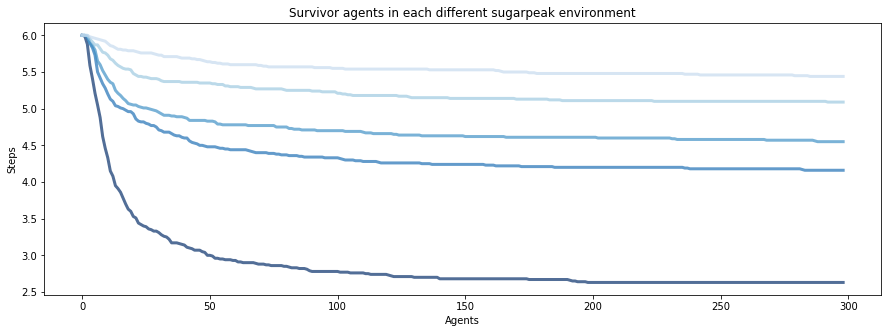

In [168]:
results = []

for i in range(0, 5):
    temp = [];
    for j in range(0,299):
        temp.append(pop_averages[i][j]/100)
    results.append(temp.copy())

fig = plt.figure(figsize = (15,5))

thinkplot.plot(results[0])
thinkplot.plot(results[1])
thinkplot.plot(results[2])
thinkplot.plot(results[3])
thinkplot.plot(results[4])
thinkplot.Config(title = 'Survivor agents in each different sugarpeak environment',
                 ylabel='Agents',
                 xlabel='Steps',
                 legend=True)

___Figure 9:___ Number of Agents still "alive" over 3 steps. Lighter colour indicates more peaks

From all the animations it is observable that the agents quickly locate to the high sugar region, this is the same effect that was observed in the initial sugarscape that was created back in chapter 0. However, unlike the initial sugarscape those unfortunate agents who do not find high peak area quickly enough or just have to high of matabolism quickly die off. This is most notable in the outer regions, and enviroments with few peaks, as the number of red agents, indicating 4 metabolism, quickly die off as the probability of surviving in these locations for those agents are low. Eventually as time progresses this results in only the green agents being left in the outer regions. The green agents are those with the lowest metabolism of 1. This seems to indicate a kind of natural selection being presented in the simulation. The agents with higher metabolisms or those that are least efficent are killed off the quickest. This then decreases the average metabolism of the group and helps to raise the carrying capacity of the enviroment. In addition, we can also see this effect being less prevelent in enviroments with a naturally higher carrying capacity, those enviroments with 4 or 5 peaks. Further indicating that this natural selection only occurs when the need for greater efficency is required. This effect will be studied further in the next section. 

Figure 9 represents the final average population scores over the 300 time steps. We do notice a decrease in population over time for each of the enviroments. This would seem to indicate the carry capacity of the enviroment, however this does not seem to match up with the availability of sugar in the enviroment. Figure 6 showed a slighty curved trend for the maximum producable sugar in the enviroment, yet figure 9 indicates a non-linear relationship. There is two explinations for this. 

First is that the maximum carrying capacity for the enviroment is not utalisable for all the agents initially placed in the enviroment. This is especially true for the outer regions as has already been identified. The local carry capacities of these outer regions is 0 as they generate no sugar. This then kills off the agents in this region before they have any time to find a better zone. Due to the fact that the enviroments with less peaks have considerably greater quanity of this area it would help to explain the rapid drop off in population sceen.

The second reason is simular to the first. Certain agents require enviroments with a greater qunaity of sugar to survive long term. This is most prevelent for agents with metabolism 4. They are extremely limited in their choice of survivable enviroment. Any areas not at the top of sugar peaks will result in their eventual death. If they are pushed off these zones due to too much competition they will have to find a way back in quickly or soon due off. This would also help to explain the slow drop off after the intial great plung as more and more agents flood into the best zones. As those unlucky agents get pushed off those that require more resources die off before they get a chance to get back into the zone. This suggest that the agents are not naturally sharing out the zone at otpimal effiency with a lot of agents that could easily survive in other areas displacing those that need this current zone to survive. Once again this draw evolutionary concepts such as "darwin survival of the fittest". As with the first issue, this second issue is also considerably less prevelent in higher the number of peaks as proportionally greater quantity of best land, so compition goes down and more of agents with higher metabolisms can survive.

To mitigate these issues the code will have to be changed by adding in the ability for birth to occure as well as death. This will help to increase the population and allow for the actual carry capacity to be meet. It will also allow for the opportunity of the evolutionary process to become more noticable as the simulation progresses.  

#### The number of agents levels off at the "carrying capacity":

In [100]:
carrying_capacity = [len(envA.agents),len(envB.agents), len(envC.agents), len(envD.agents), len(envE.agents)]
carrying_capacity

[250, 417, 468, 495, 542]

In [ ]:
higher_capacity_locations = [envA.higher_capacity_locations,envB.higher_capacity_locations,envC.higher_capacity_locations,envD.higher_capacity_locations,envE.higher_capacity_locations]
higher_capacity_locations

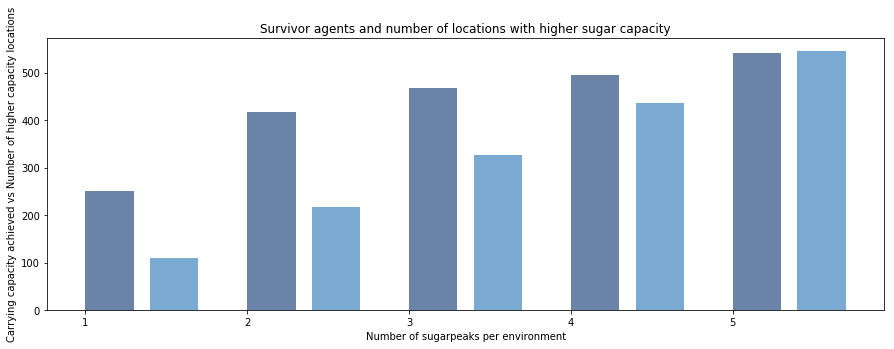

In [114]:
fig = plt.figure(figsize = (15,5))

thinkplot.Bar([1,2,3,4,5],carrying_capacity, width=0.3, align='edge')
thinkplot.Bar([1.4,2.4,3.4,4.4,5.4],higher_capacity_locations, width=0.3, align='edge')
thinkplot.Config(title = 'Survivor agents and number of locations with higher sugar capacity',
                 xlabel='Number of sugarpeaks per environment',
                 ylabel='Carrying capacity achieved vs Number of higher capacity locations',
                 legend=True)

The graph above shows the "carrying capacity" changes drastically within the first 100 steps, after that the "carrying capacity" decreased at a much lower rate, as a result the difference of caarrying capacity between the step 200 and 500 is relative short.

### Overpopulation

The replication of the experiemnt included 400 agents, where all the agents best positioned and the ones who succesfully got into the higher capacity sugar zones were the ones who last until the replication was completed, this ocurred in every environment, even when the number of sugar peaks were different.  

This time we will introduced more agents, 800 agents, to overpopulate the environments. Are we going to get the same results? 

There will be no changes of any other parameter, only the number of agents. _Agents = 800_


In [108]:
# One sugar peaks
envOverA = Sugarscape(50, num_agents=2000, sugarpeaks=sugarpeaksA)
viewerOverA = SugarscapeViewer(envOverA)
# Two sugar peaks
envOverB = Sugarscape(50, num_agents=2000, sugarpeaks=sugarpeaksB)
viewerOverB = SugarscapeViewer(envOverB)
# Three sugar peaks
envOverC = Sugarscape(50, num_agents=2000, sugarpeaks=sugarpeaksC)
viewerOverC = SugarscapeViewer(envOverC)
# Four sugar peaks
envOverD = Sugarscape(50, num_agents=2000, sugarpeaks=sugarpeaksD)
viewerOverD = SugarscapeViewer(envOverD)
# Five sugar peaks
envOverE = Sugarscape(50, num_agents=2000, sugarpeaks=sugarpeaksE)
viewerOverE = SugarscapeViewer(envOverE)

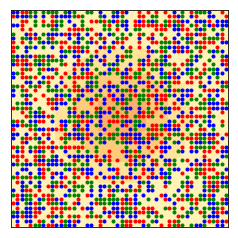

In [109]:
animOverA  =  viewerOverA.animate(frames=200)
animOverA

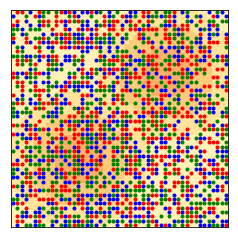

In [111]:
animOverB  =  viewerOverB.animate(frames=200)
animOverB

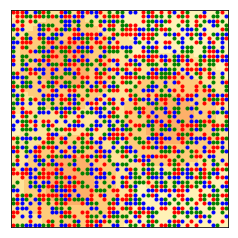

In [113]:
animOverC  =  viewerOverC.animate(frames=200)
animOverC

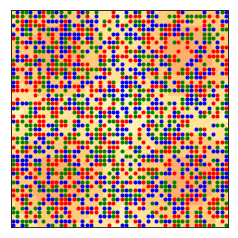

In [115]:
animOverD  =  viewerOverD.animate(frames=200)
animOverD

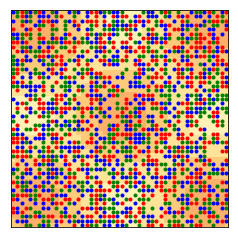

In [117]:
animOverE  =  viewerOverE.animate(frames=200)
animOverE

In [119]:
over_carrying_capacity = [len(envOverA.agents),len(envOverB.agents), len(envOverC.agents), len(envOverD.agents), len(envOverE.agents)]
over_carrying_capacity

[509, 827, 1020, 1168, 1130]

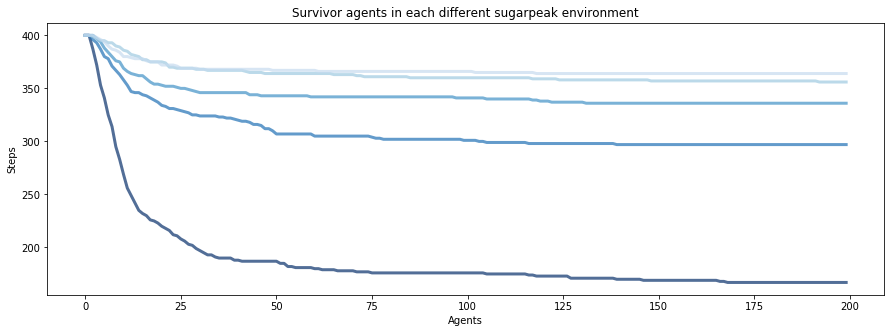

In [120]:
fig = plt.figure(figsize = (15,5))

thinkplot.plot(envA.agent_count_seq)
thinkplot.plot(envB.agent_count_seq)
thinkplot.plot(envC.agent_count_seq)
thinkplot.plot(envD.agent_count_seq)
thinkplot.plot(envE.agent_count_seq)
thinkplot.Config(title = 'Survivor agents in each different sugarpeak environment',
                 xlabel='Agents',
                 ylabel='Steps',
                 legend=False)

In [121]:
over_higher_capacity_locations = [envA.higher_capacity_locations,envB.higher_capacity_locations,envC.higher_capacity_locations,envD.higher_capacity_locations,envE.higher_capacity_locations]
over_higher_capacity_locations

[109, 218, 327, 436, 517]

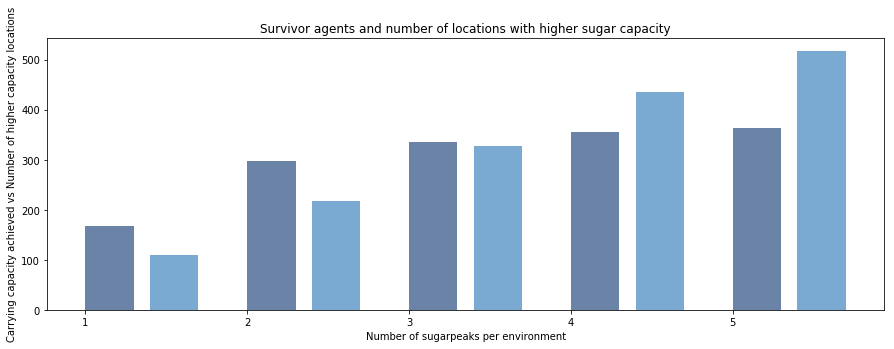

In [122]:
fig = plt.figure(figsize = (15,5))

thinkplot.Bar([1,2,3,4,5],carrying_capacity, width=0.3, align='edge')
thinkplot.Bar([1.4,2.4,3.4,4.4,5.4],higher_capacity_locations, width=0.3, align='edge')
thinkplot.Config(title = 'Survivor agents and number of locations with higher sugar capacity',
                 xlabel='Number of sugarpeaks per environment',
                 ylabel='Carrying capacity achieved vs Number of higher capacity locations',
                 legend=True)

### Metabolism in sugarscape agents after 500 steps

We compare the two environment agents survivors between the regular population environment and the over populated environment.

C:\Users\Rhys\Documents\GitHub\sugascape\thinkplot.py:114: UserWarning: Ran out of colors.  Starting over.
  warnings.warn('Ran out of colors.  Starting over.')


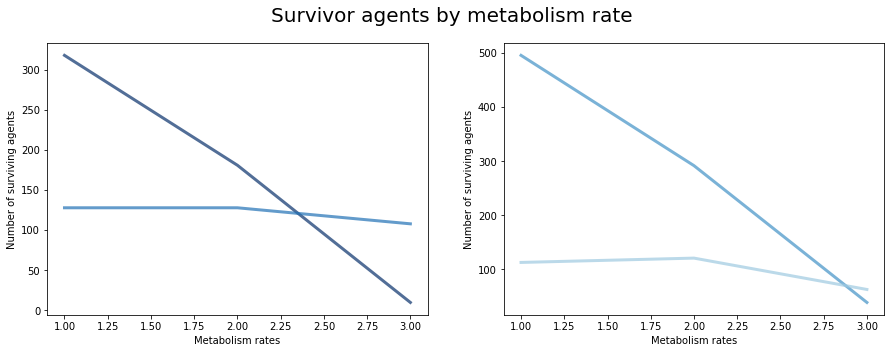

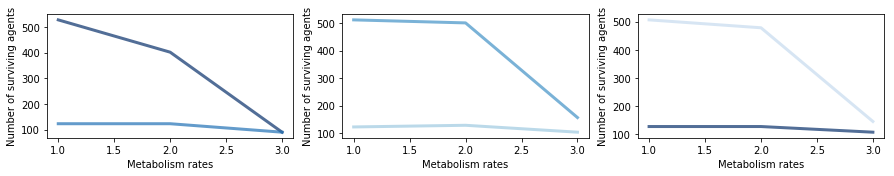

In [123]:
fig = plt.figure(figsize = (15,5))
fig.suptitle('Survivor agents by metabolism rate',fontsize=20)

ax1 = fig.add_subplot(1,2,1)
# Adding over populated environment with one sugar peak
low_met,mid_met,high_met = envOverA.agents_metabolism_counter()
met = [low_met,mid_met,high_met]
thinkplot.plot([1,2,3],met)
thinkplot.Config(xlabel='Metabolism rates',
                 ylabel='Number of surviving agents')
# Adding regular populated environment with one sugar peak
low_met,mid_met,high_met = envE.agents_metabolism_counter()
met = [low_met,mid_met,high_met]
thinkplot.plot([1,2,3],met)
thinkplot.Config(xlabel='Metabolism rates',
                 ylabel='Number of surviving agents')

ax2 = fig.add_subplot(1,2,2)
# Adding over populated environment with two sugar peak
low_met,mid_met,high_met = envOverB.agents_metabolism_counter()
met = [low_met,mid_met,high_met]
thinkplot.plot([1,2,3],met)
thinkplot.Config(xlabel='Metabolism rates',
                 ylabel='Number of surviving agents')
# Adding regular populated environment with two sugar peak
low_met,mid_met,high_met = envB.agents_metabolism_counter()
met = [low_met,mid_met,high_met]
thinkplot.plot([1,2,3],met)
thinkplot.Config(xlabel='Metabolism rates',
                 ylabel='Number of surviving agents')

fig = plt.figure(figsize = (15,5))
ax3 = fig.add_subplot(2,3,1)
# Adding over populated environment with three sugar peak
low_met,mid_met,high_met = envOverC.agents_metabolism_counter()
met = [low_met,mid_met,high_met]
thinkplot.plot([1,2,3],met)
thinkplot.Config(xlabel='Metabolism rates',
                 ylabel='Number of surviving agents')
# Adding regular populated environment with three sugar peak
low_met,mid_met,high_met = envC.agents_metabolism_counter()
met = [low_met,mid_met,high_met]
thinkplot.plot([1,2,3],met)
thinkplot.Config(xlabel='Metabolism rates',
                 ylabel='Number of surviving agents')

ax4 = fig.add_subplot(2,3,2)
# Adding over populated environment with four sugar peak
low_met,mid_met,high_met = envOverD.agents_metabolism_counter()
met = [low_met,mid_met,high_met]
thinkplot.plot([1,2,3],met)
thinkplot.Config(xlabel='Metabolism rates',
                 ylabel='Number of surviving agents')
# Adding regular populated environment with four sugar peak
low_met,mid_met,high_met = envD.agents_metabolism_counter()
met = [low_met,mid_met,high_met]
thinkplot.plot([1,2,3],met)
thinkplot.Config(xlabel='Metabolism rates',
                 ylabel='Number of surviving agents')

ax5 = fig.add_subplot(2,3,3)
# Adding over populated environment with five sugar peak
low_met,mid_met,high_met = envOverE.agents_metabolism_counter()
met = [low_met,mid_met,high_met]
thinkplot.plot([1,2,3],met)
thinkplot.Config(xlabel='Metabolism rates',
                 ylabel='Number of surviving agents')
# Adding regular populated environment with five sugar peak
low_met,mid_met,high_met = envE.agents_metabolism_counter()
met = [low_met,mid_met,high_met]
thinkplot.plot([1,2,3],met)
thinkplot.Config(xlabel='Metabolism rates',
                 ylabel='Number of surviving agents')


### Overpopulated environment outcomes

We have interesting results in our replication with overpopulation. The graphs above compare each one of the environments with diffent number of initial agents, regular population initiates with 400 agents and overpopulated environments initiates with 1600 agents.

The biggest different of behavior is in over populated environments, it shows an *emergent behaviour* where the agents with higher metabolism have very low probabilities to last the 500 steps within the replication, even when the same environment with less agents have a similar number of different metabolism lasting the replication to completion.

It is interesting how given environment with less sugar to share and a huge amount of 'enemies' looking for the best sugar position lead to a survival fight where the stronger or the one with best capabilities will survive.

# References

1. Schelling, T. (1969). Models of Segregation. The American Economic Review, 59(2), 488–493.
2. Epstein, J. & Axtell, R. (1996). Growing Artificial Societies: Social Science from the Bottom Up. Place of publication not identified: MIT Press.

In [124]:
class Agent:
    
    def __init__(self, loc, params):
        """Creates a new agent at the given location.
        
        loc: tuple coordinates
        params: dictionary of parameters
        """
        self.loc = tuple(loc)
        self.age = 0
        #self.color = 'red'
        # extract the parameters
        max_vision = params.get('max_vision', 6)
        max_metabolism = params.get('max_metabolism', 4)
        min_lifespan = params.get('min_lifespan', 10000)
        max_lifespan = params.get('max_lifespan', 10000)
        min_sugar = params.get('min_sugar', 5)
        max_sugar = params.get('max_sugar', 25)
        
        # choose attributes
        self.vision = np.random.randint(1, max_vision+1)
        self.metabolism = np.random.uniform(1, max_metabolism)
        self.lifespan = np.random.uniform(min_lifespan, max_lifespan)
        self.sugar = np.random.uniform(min_sugar, max_sugar)
        self.color = self.agent_color()

    def step(self, env):
        """Look around, move, and harvest.
        
        env: Sugarscape
        """
        self.loc = env.look_around(self.loc, self.vision)
        self.sugar += env.harvest(self.loc) - self.metabolism
        self.age += 1

    def is_starving(self):
        """Checks if sugar has gone negative."""
        return self.sugar < 0
    
    def is_old(self):
        """Checks if lifespan is exceeded."""
        return self.age > self.lifespan
    
    def agent_color(self):
        if self.metabolism <= 2: 
            return 'green'
        elif self.metabolism <= 3:
            return 'blue'
        elif self.metabolism <= 4:
            return 'red' 
        else: 
            return'yellow'

In [169]:
class Sugarscape(Cell2D):
    """Represents an Epstein-Axtell Sugarscape."""
    
    def __init__(self, n, **params):
        """Initializes the attributes.

        n: number of rows and columns
        params: dictionary of parameters
        """
        self.n = n
        self.params = params
        
        # track variables
        self.agent_count_seq = []
        self.grow_rate = params.get('growth_rate', 4)
        self.sugarpeaks = params.get('sugarpeaks', [[15,15],[35,35]])
        self.capacity,self.higher_capacity_locations  = self.make_capacity()
        #self.higher_capacity_locations
        
        # initially all cells are at capacity
        self.array = self.capacity.copy()
        
        # make the agents
        self.make_agents()
        #self.agents = self.make_agents()
        
        
    def make_capacity(self):
        """Makes the capacity array."""
        
        # compute the distance of each cell from the peaks. 
        x = np.arange(self.n)
        rows, cols = np.meshgrid(x, x, indexing='ij')
        
        # each cell in `rows` contains its own `i` coordinate
        # each cell in `cols` contains its `j` coordinate
        # creates the sugar peaks at this positions
        distHypots = []
        dist = np.hypot(rows-self.sugarpeaks[0][0], cols-self.sugarpeaks[0][1])
        for sugarpeakPos in self.sugarpeaks:
            distHypots.append(np.hypot(rows-sugarpeakPos[0], cols-sugarpeakPos[1]))
        
        for distHypot in distHypots:
            dist = np.minimum(dist, distHypot)
        
        # cells in the capacity array are set according to dist from peak
        a = np.zeros((self.n, self.n), np.float)
        a[dist>=16] = 1
        a[dist<16] = 2
        a[dist<11] = 3
        a[dist<6] = 4
        higher_capacity_counter = len(a[dist<6] == 4)
        
        return a, higher_capacity_counter 
        
    def make_agents(self):
        """Makes the agents."""
        
        # determine where the agents start and generate locations
        n, m = self.params.get('starting_box', self.array.shape)
        locs = make_locs(n, m)
        np.random.shuffle(locs)

        # make the agents
        num_agents = self.params.get('num_agents', 400)
        self.agents = [Agent(locs[i], self.params) 
                       for i in range(num_agents)]
        
        # keep track of which cells are occupied
        self.occupied = set(agent.loc for agent in self.agents)
        return self.agents
            
    def grow(self):
        """Adds sugar to all cells and caps them by capacity."""
        grow_rate = self.params.get('grow_rate', self.grow_rate)
        self.array = np.minimum(self.array + grow_rate, self.capacity)
        
    def look_around(self, center, vision):
        """Finds the visible cell with the most sugar.
        
        center: tuple, coordinates of the center cell
        vision: int, maximum visible distance
        
        returns: tuple, coordinates of best cell
        """
        # find all visible cells
        locs = make_visible_locs(vision)
        locs = (locs + center) % self.n
        
        # convert rows of the array to tuples
        locs = [tuple(loc) for loc in locs]
        
        # select unoccupied cells
        empty_locs = [loc for loc in locs if loc not in self.occupied]
        
        # if all visible cells are occupied, stay put
        if len(empty_locs) == 0:
            return center
        
        # look up the sugar level in each cell
        t = [self.array[loc] for loc in empty_locs]
        
        # find the best one and return it
        # (in case of tie, argmax returns the first, which
        # is the closest)
        i = np.argmax(t)
        
        return empty_locs[i]
    
    def harvest(self, loc):
        """Removes and returns the sugar from `loc`.
        
        loc: tuple coordinates
        """
        sugar = self.array[loc]
        self.array[loc] = 0
        return sugar
    
    def step(self):
        """Executes one time step."""
        replace = self.params.get('replace', False)
        
        # loop through the agents in random order
        random_order = np.random.permutation(self.agents)
        for agent in random_order:
            
            # mark the current cell unoccupied
            self.occupied.remove(agent.loc)
            
            # execute one step
            agent.step(self)

            # if the agent is dead, remove from the list
            if agent.is_starving() or agent.is_old():
                self.agents.remove(agent)
                if replace:
                    self.add_agent()
            else:
                # otherwise mark its cell occupied
                self.occupied.add(agent.loc)

        # update the time series
        self.agent_count_seq.append(len(self.agents))
        
        # grow back some sugar
        self.grow()
        return len(self.agents)
    
    def add_agent(self):
        """Generates a new random agent.
                
        returns: new Agent
        """
        new_agent = Agent(self.random_loc(), self.params)
        self.agents.append(new_agent)
        self.occupied.add(new_agent.loc)
        return new_agent
    
    def random_loc(self):
        """Choose a random unoccupied cell.
        
        returns: tuple coordinates
        """
        while True:
            loc = tuple(np.random.randint(self.n, size=2))
            if loc not in self.occupied:
                return loc
            
    def agents_metabolism_counter(self):
        low_met = 0
        mid_met = 0
        high_met = 0
        for agent in self.agents:
            if agent.color=='green':
                low_met = low_met+1
            elif agent.color=='blue':
                mid_met=mid_met+1
            elif agent.color=='red':
                high_met=high_met+1
        return low_met, mid_met, high_met

In [183]:
import io
import sys

s = io.StringIO('2\n\
4\n\
')

sys.stdin  = s


In [184]:
val1 = input()
print(val1)

asildas
asildas
